In [1]:
# Imports

import pandas as pd
import numpy as np
import geopandas as gpd
import warnings
import folium
import math
import branca
from geopy import distance
from tqdm import tqdm
import ast
import networkx as nx
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from pyvis.network import Network

warnings.filterwarnings('ignore')

In [2]:
phd = pd.read_excel(open('source/PhD & Gender.xlsx', 'rb'), sheet_name='PhDV3Genre (4)')

In [3]:
ref = pd.read_csv('source/References data.csv')

In [4]:
phd.drop(columns=['Column3','Column2','Column1','X.1','X','Identifiant.auteur'], inplace=True)

- Map distribution of genders in academies.

In [4]:
opendata = pd.read_csv('source/opendata.csv')
opendata.rename(columns={'Libellé':'etablissement_rec'}, inplace=True)

In [6]:
phd.replace({'Ã©':'é'}, regex=True, inplace=True)
phd.replace({'Ã¨':'è'}, regex=True, inplace=True)
phd.replace({'Ãª':'ê'}, regex=True, inplace=True)
phd.replace({'Ã´':'ô'}, regex=True, inplace=True)
phd.replace({'Ã§':'ç'}, regex=True, inplace=True)
phd.replace({'Ã¹':'ù'}, regex=True, inplace=True)
phd.replace({'Ã®':'î'}, regex=True, inplace=True)
phd.replace({'Ã¯':'ï'}, regex=True, inplace=True)
phd.replace({'Â’':"'"}, regex=True, inplace=True)
phd.replace({'Ã‰':'É'}, regex=True, inplace=True)
phd.replace({'Ã':'à'}, regex=True, inplace=True)

In [7]:
phd = phd.merge(opendata[['etablissement_rec','Académie']], on='etablissement_rec', how='left')

In [8]:
phd['genre_value'] = np.select(
    [
        phd['Genre'] == 'male',
        phd['Genre'] == 'mostly_male',
        phd['Genre'] == 'female',
        phd['Genre'] == 'mostly_female',
    ],
    [
        0,
        0,
        1,
        1
    ]
)

In [9]:
phd_genred = phd[(phd['Genre'] != 'andy') & (phd['Genre'] != 'unknown')]
phd_genred = phd_genred[phd_genred['Genre'].notna()]

In [10]:
gender_by_academy = phd_genred.groupby('Académie')['genre_value'].mean().reset_index()
gender_by_academy['Académie'] = 'Académie de ' + gender_by_academy['Académie']
gender_by_academy['Académie'][gender_by_academy['Académie'] == 'Académie de Aix-Marseille'] = "Académie d'Aix-Marseille"
gender_by_academy['Académie'][gender_by_academy['Académie'] == 'Académie de Amiens'] = "Académie d'Amiens"
gender_by_academy['Académie'][gender_by_academy['Académie'] == 'Académie de Orléans-Tours'] = "Académie d'Orléans-Tours"

<AxesSubplot:title={'center':'School Districts Map by Gender Representation'}>

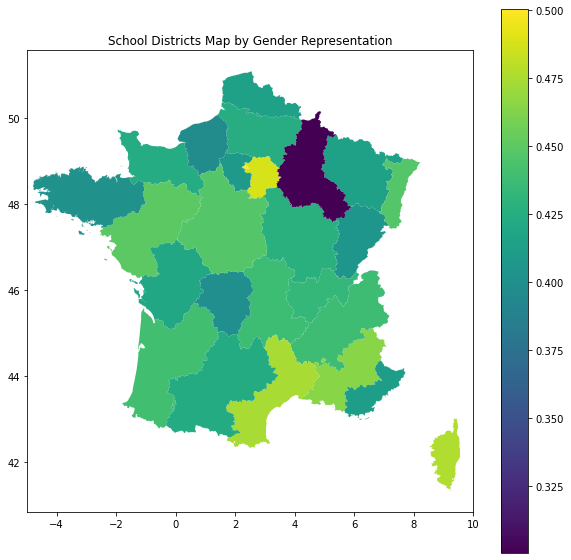

In [11]:
school = gpd.read_file('source/academies-20160209.shp')

gender_by_academy.rename(columns={'Académie':'name'}, inplace=True)
school = school.merge(gender_by_academy, on='name', how='left')

school.drop(school.index[school['name'] == 'Académie de Guyane'], inplace = True)
school.drop(school.index[school['name'] == 'Académie de la Guadeloupe'], inplace = True)
school.drop(school.index[school['name'] == 'Académie de la Martinique'], inplace = True)
school.drop(school.index[school['name'] == 'Académie de la Réunion'], inplace = True)

map_school = school.plot(figsize=(10,10), column='genre_value', cmap='viridis', legend=True)
map_school.set_title('School Districts Map by Gender Representation')
map_school.set_xlim(-5, 10)
map_school

In [60]:
phd.to_csv('PhD_fixed.csv', index=False)

In [2]:
phd = pd.read_csv('PhD_fixed.csv')

- Interactive bubble plot.

In [5]:
phd = phd.merge(opendata[['etablissement_rec','Géolocalisation']], on='etablissement_rec', how='left')

In [14]:
phd_for_gender = phd.groupby(phd['etablissement_rec'], as_index=False).aggregate({'Géolocalisation':'first','Auteur':'count','genre_value':'mean'})
phd_for_gender = phd_for_gender[phd_for_gender['Géolocalisation'].notna()]

In [21]:
colormap = branca.colormap.LinearColormap(colors=['red','blue'], index=[0,0.6],vmin=0,vmax=0.6)

In [16]:
m = folium.Map(location=[48.86,2.34], tiles="OpenStreetMap", zoom_start=6)

for i in range(0,len(phd_for_gender)):
   folium.Circle(
      location=[phd_for_gender.iloc[i]['Géolocalisation'].split(',')[0], phd_for_gender.iloc[i]['Géolocalisation'].split(',')[1]],
      popup=phd_for_gender.iloc[i]['etablissement_rec'], radius=math.log(phd_for_gender.iloc[i]['Auteur'].astype(float)) * 2000,
      color=colormap(phd_for_gender.iloc[i]['genre_value']), fill=True, opacity=1, fillopacity=1,
      fill_color=colormap(phd_for_gender.iloc[i]['genre_value'])
   ).add_to(m)

m.add_child(colormap)
display(m)

- Computing distances.

In [71]:
auteur_directeur = set(phd['Auteur']).intersection(set(phd['Directeur.de.these.1']))

In [75]:
phd_dist = phd[phd['Auteur'].isin(auteur_directeur) | phd['Directeur.de.these.1'].isin(auteur_directeur)].sort_values(by='Date.de.soutenance')
len_dist = [len(phd_dist),len(phd)]
print('Current Loss - '+str(len_dist[1]-len_dist[0]))
phd_dist = phd_dist[phd_dist['Géolocalisation'].notna()]
len_dist[1] = len_dist[0]
len_dist[0] = len(phd_dist)
print('Current Loss - '+str(len_dist[1]-len_dist[0]))
phd_dist['director_step'] = phd_dist['Directeur.de.these.1'] + ' - ' + (phd_dist.groupby('Directeur.de.these.1').cumcount() + 1).astype(str)
phd_dist['author_step'] = phd_dist['Auteur'] + ' - ' + (phd_dist.groupby('Auteur').cumcount() + 1).astype(str)

Current Loss - 206240
Current Loss - 5157


In [ ]:
phd_dist = phd_dist[phd_dist['Directeur.de.these.2'].isna() & phd_dist['Directeur.de.these.3'].isna() & phd_dist['Directeur.de.these.4'].isna()]

In [30]:
distances = pd.DataFrame(columns=['author','first_geo','second_geo'])

for i in range(len(phd_dist)):
    if str(phd_dist.iloc[i]['author_step'])[-1] == '1':
        author = phd_dist.iloc[i]['Auteur']
        first_geo = phd_dist.iloc[i]['Géolocalisation']
        try:
            second_geo = phd_dist.loc[phd_dist['director_step'] == author + ' - 1', 'Géolocalisation'].iloc[0]
            s = pd.Series([author, first_geo, second_geo], index=distances.columns)
            distances = distances.append(s, ignore_index=True)
        except IndexError:
            pass

In [12]:
directors = phd_dist['Directeur.de.these.1'].unique()
distances = pd.DataFrame(columns=['author','geos'])

for i in tqdm(range(directors.shape[0])):
    author = directors[i]
    try:
        geos = [phd_dist.loc[phd_dist['author_step'] == author + ' - 1', 'Géolocalisation'].iloc[0]]
    except:
        geos = ['0,0']
    k = 0
    while True:
        k += 1
        try:
            geo = phd_dist.loc[phd_dist['director_step'] == author + ' - ' + str(k), 'Géolocalisation'].iloc[0]
            geos.append(geo)
        except:
            break
    s = pd.Series({'author':author, 'geos':geos})
    distances = distances.append(s, ignore_index=True)


100%|██████████| 18107/18107 [05:46<00:00, 52.26it/s]


In [19]:
distances.to_csv('distances.csv', index=False)

In [3]:
distances = pd.read_csv('distances.csv')
distances['geos'] = distances['geos'].apply(ast.literal_eval)

In [114]:
dist = pd.DataFrame([pd.Series(x) for x in distances.geos])
dist.columns = ['geo_{}'.format(x+1) for x in dist.columns]
dist.rename(columns={'geo_1':'geo_phd'}, inplace=True)
dist.replace('0,0','', inplace=True)
dist.fillna('', inplace=True)
dist.insert(0, 'author', distances['author'])

In [115]:
dist = dist[dist['geo_phd'] != '']

In [116]:
dist_endo = dist[['author','geo_phd','geo_2']]

In [7]:
dist = dist.apply(lambda row: pd.Series(row).drop_duplicates(keep='first'),axis='columns')
dist = dist.apply(lambda x : pd.Series(x[x.notnull()].values.tolist()+x[x.isnull()].values.tolist()),axis='columns')

In [8]:
s = dist.to_numpy()
orders = np.argsort(s=='', axis=1, kind='mergesort')
dist[:] = s[np.arange(len(s))[:,None], orders]

In [9]:
dist = dist[dist[0] != 'Directeur de these inconnu']
dist.dropna(axis=1, how='all', inplace=True)
dist = dist.iloc[:,:-1]

In [10]:
dist = dist[dist[2].notna()]

In [11]:
dist_inv = dist.shift(-1, axis=1)
dist_values = dist.copy()

In [12]:
for i in tqdm(range(dist.shape[0])):
    for k in range(dist.shape[1]):
        dist_values.iloc[i][k] = np.nan
        try:
            dist_values.iloc[i][k] = distance.geodesic(dist.iloc[i,k], dist_inv.iloc[i,k]).km
        except:
            pass

100%|██████████| 5529/5529 [00:05<00:00, 1019.37it/s]


In [13]:
dist_values[0] = dist[0]

In [14]:
dist_values.to_csv('distances_values.csv', index=False)

- Analyzing distances. [Task given to Maxime]

In [92]:
dist_values.rename(columns={0:'Auteur'}, inplace=True)
dist_values.rename(columns={1:'mov_phd_dir'}, inplace=True)

In [93]:
phd = phd.merge(dist_values[['Auteur','mov_phd_dir']], on='Auteur', how='left')

In [98]:
phd['mov_phd_dir'].mean()

405.23885777067073

- Representing the edges.

In [14]:
edges = []

for i in tqdm(range(dist.shape[0])):
    coords = []
    for k in range(dist.shape[1]-1):
        if not pd.isna(dist.iloc[i,k+1]):
            coords.append(dist.iloc[i,k+1])
        else:
            continue
        if len(coords) == 2:
            edges.append(coords)
            coords = coords[1:]

edges = pd.DataFrame(edges, columns=['start','end'])

100%|██████████| 5529/5529 [00:00<00:00, 7884.07it/s]


In [15]:
edges = edges.groupby(['start','end']).size().reset_index(name='count')

In [16]:
edges[['start_lat','start_long']] = edges['start'].str.split(',',1,expand=True)
edges[['end_lat','end_long']] = edges['end'].str.split(',',1,expand=True)

In [31]:
m = folium.Map(location=[48.86,2.34], zoom_start=5, tiles='cartodbpositron')

for i in range(len(edges)):
    loc = [(float((edges.iloc[i]['start_lat']).replace('-','-')), float((edges.iloc[i]['start_long']).replace('-','-'))), 
        (float((edges.iloc[i]['end_lat']).replace('-','-')), float((edges.iloc[i]['end_long']).replace('-','-')))]
    folium.PolyLine(locations=loc, color=colormap(edges.iloc[i]['count']/10), opacity=0.5, weight=edges.iloc[i]['count']/10).add_to(m)

m

- Analyzing the network.

In [33]:
uni_list = phd[['etablissement_rec','Géolocalisation']].drop_duplicates().reset_index(drop=True)
uni_list.rename(columns={'etablissement_rec':'start_uni','Géolocalisation':'start'}, inplace=True)
edges = edges.merge(uni_list, on='start', how='left')
uni_list.rename(columns={'start_uni':'end_uni','start':'end'}, inplace=True)
edges = edges.merge(uni_list, on='end', how='left')

In [47]:
G = nx.from_pandas_edgelist(edges, 'start_uni', 'end_uni', edge_attr=True, create_using=nx.DiGraph())

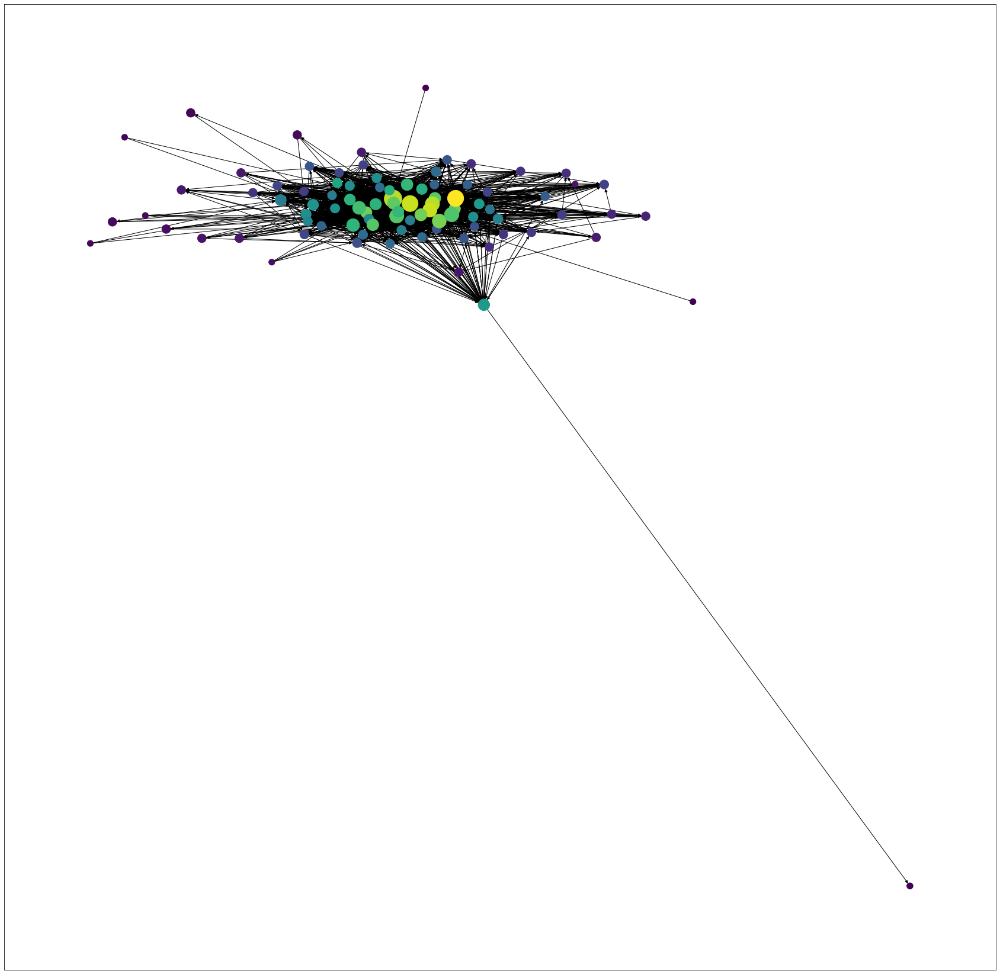

In [88]:
pos = nx.spring_layout(G)
betCent = nx.betweenness_centrality(G, normalized=True, endpoints=True)
node_color = [20000.0 * G.degree(v) for v in G]
node_size =  [v * 10000 for v in betCent.values()]
plt.figure(figsize=(30,30))
nx.draw_networkx(G, pos=pos, with_labels=False,
                 node_color=node_color,
                 node_size=node_size )
plt.show()

In [89]:
uni_betCent = pd.DataFrame.from_dict(betCent, orient='index').sort_values(by=0, ascending=False)
uni_betCent

,0
Aix-Marseille Université,0.088690
Sorbonne Université,0.073895
Université Paris-Saclay,0.073030
Université de Nantes,0.058772
Université de Strasbourg,0.057386
...,...
Université de Guyane,0.010362
École nationale supérieure de mécanique et d'aérotechnique de Poitiers,0.010362
Institut national des sciences appliquées Centre Val de Loire,0.010362
Université de la Nouvelle-Calédonie,0.010362


- Treating dist for Jasmine.

In [84]:
cols_lat, cols_long = [], []

for i in range(1,dist.shape[1]):
    cols_lat.append(str(i)+'_lat')
    cols_long.append(str(i)+'_long')

for i in range(dist.shape[1]-1):
    dist[[cols_lat[i], cols_long[i]]] = dist[i+1].str.split(',',1,expand=True)

In [85]:
dist.to_csv('dist_jas.csv', index=False)

- Studying the movement endogamy.

In [117]:
dist_endo.rename(columns={'geo_2':'geo_super'}, inplace=True)

In [118]:
dist_endo.replace('', pd.NA, inplace=True)

In [119]:
dist_endo['distance'] = [None] * dist_endo.shape[0]
dist_endo.reset_index(inplace=True)

In [120]:
for i in tqdm(range(dist_endo.shape[0])):
    if pd.notna(dist_endo.iloc[i]['geo_phd']) and pd.notna(dist_endo.iloc[i]['geo_super']):
        dist_endo.loc[i,'distance'] = distance.geodesic(dist_endo.iloc[i]['geo_phd'], dist_endo.iloc[i]['geo_super']).km
    else:
        dist_endo.loc[i,'distance'] = 0

100%|██████████| 9450/9450 [00:04<00:00, 2066.37it/s]


In [121]:
for i in range(dist_endo.shape[0]):
    if dist_endo.loc[i,'distance'] == 0:
        dist_endo.loc[i,'endo'] = 1
    else:
        dist_endo.loc[i,'endo'] = 0

In [122]:
dist_endo['endo'].value_counts(normalize=True) * 100

0.0    55.248677
1.0    44.751323
Name: endo, dtype: float64

In [123]:
uni_list = phd[['etablissement_rec','Géolocalisation','Académie']].drop_duplicates().reset_index(drop=True)
uni_list.rename(columns={'etablissement_rec':'uni_phd','Géolocalisation':'geo_phd','Académie':'aca_phd'}, inplace=True)
dist_endo = dist_endo.merge(uni_list, on='geo_phd', how='left')
uni_list.rename(columns={'uni_phd':'uni_super','geo_phd':'geo_super','aca_phd':'aca_super'}, inplace=True)
dist_endo = dist_endo.merge(uni_list, on='geo_super', how='left')
dist_endo.drop_duplicates(subset='author', keep='last', inplace=True)

In [124]:
school = gpd.read_file('source/academies-20160209.shp')

endo_by_academy = dist_endo.groupby('aca_phd')['endo'].mean().reset_index()
endo_by_academy.rename(columns={'aca_phd':'name'}, inplace=True)
endo_by_academy['name'] = 'Académie de ' + endo_by_academy['name']
endo_by_academy['name'][endo_by_academy['name'] == 'Académie de Aix-Marseille'] = "Académie d'Aix-Marseille"
endo_by_academy['name'][endo_by_academy['name'] == 'Académie de Amiens'] = "Académie d'Amiens"
endo_by_academy['name'][endo_by_academy['name'] == 'Académie de Orléans-Tours'] = "Académie d'Orléans-Tours"
school = school.merge(endo_by_academy, on='name', how='left')

school.explore(column='endo', tooltip=True, cmap='RdYlGn', style_kwds=dict(color="black"))

In [125]:
author_gender = phd[['Auteur','genre_value']]
author_gender.rename(columns={'Auteur':'author'}, inplace=True)
dist_endo = dist_endo.merge(author_gender, on='author', how='left')
dist_endo.drop_duplicates(subset='author', keep='last', inplace=True)

In [79]:
dist_endo.corr()

,index,endo,genre_value
index,1.000000,0.350937,0.107775
endo,0.350937,1.000000,0.027761
genre_value,0.107775,0.027761,1.000000


In [80]:
endo_by_uni = dist_endo.groupby('uni_phd')['endo','genre_value'].mean().reset_index().sort_values(by='endo', ascending=False)
endo_by_uni

,uni_phd,endo,genre_value
10,Institut national des sciences appliquées de R...,0.973451,0.159292
1,Arts et Métiers Sciences et Technologies,0.964286,0.000000
56,Université de La Réunion,0.962963,0.024691
37,Université Polytechnique Hauts-de-France,0.952381,0.095238
75,Université de technologie de Troyes,0.948718,0.000000
...,...,...,...
19,Université Bretagne Sud,0.142857,0.285714
27,Université Le Havre Normandie,0.000000,0.000000
73,Université de la Polynésie Française,0.000000,0.000000
77,École nationale supérieure de chimie de Rennes,0.000000,0.000000


In [81]:
endo_by_uni = endo_by_uni.merge(dist_endo[['geo_phd','uni_phd']], on='uni_phd', how='left').drop_duplicates().reset_index(drop=True)

In [90]:
m = folium.Map(location=[48.86,2.34], tiles="OpenStreetMap", zoom_start=6)

for i in range(0,len(endo_by_uni)):
   folium.Circle(
      location=[endo_by_uni.iloc[i]['geo_phd'].split(',')[0], endo_by_uni.iloc[i]['geo_phd'].split(',')[1]],
      popup=endo_by_uni.iloc[i]['uni_phd'], radius=endo_by_uni.iloc[i]['endo'] * 50000,
      color=colormap(endo_by_uni.iloc[i]['genre_value']), fill=True, opacity=1, fillopacity=1,
      fill_color=colormap(endo_by_uni.iloc[i]['genre_value'])
   ).add_to(m)

m.add_child(colormap)
display(m)

In [88]:
m = folium.Map(location=[48.86,2.34], tiles="OpenStreetMap", zoom_start=6)

for i in range(0,len(endo_by_uni)):
   folium.Circle(
      location=[endo_by_uni.iloc[i]['geo_phd'].split(',')[0], endo_by_uni.iloc[i]['geo_phd'].split(',')[1]],
      popup=endo_by_uni.iloc[i]['uni_phd'], radius=25000,
      color=colormap(endo_by_uni.iloc[i]['endo']), fill=True, opacity=1, fillopacity=1,
      fill_color=colormap(endo_by_uni.iloc[i]['endo'])
   ).add_to(m)

m.add_child(colormap)
display(m)

In [ ]:
dist_endo.to_csv('endo.csv', index=False)

- Studying the co-directorship.

In [2]:
phd = pd.read_csv('PhD_fixed.csv')

In [3]:
phd_co = phd[phd['Directeur.de.these.2'].notna()].reset_index(drop=True)

In [4]:
dirs = pd.unique(phd_co[['Directeur.de.these.1','Directeur.de.these.2','Directeur.de.these.3','Directeur.de.these.4']].values.ravel('K'))
dirs = pd.DataFrame(dirs, columns=['dir'])

In [5]:
cosup = phd_co.groupby('Directeur.de.these.1')['etablissement_rec'].value_counts().reset_index(name='count')
cosup.rename(columns={'Directeur.de.these.1':'Directeur.de.these.2'}, inplace=True)
cosup = cosup.append(phd_co.groupby('Directeur.de.these.2')['etablissement_rec'].value_counts().reset_index(name='count'))
cosup.rename(columns={'Directeur.de.these.2':'Directeur.de.these.3'}, inplace=True)
cosup = cosup.append(phd_co.groupby('Directeur.de.these.3')['etablissement_rec'].value_counts().reset_index(name='count'))
cosup.rename(columns={'Directeur.de.these.3':'Directeur.de.these.4'}, inplace=True)
cosup = cosup.append(phd_co.groupby('Directeur.de.these.4')['etablissement_rec'].value_counts().reset_index(name='count'))
cosup.rename(columns={'Directeur.de.these.4':'director'}, inplace=True)
dir_uni = cosup.groupby(['director','etablissement_rec']).sum().reset_index()

In [6]:
dir_uni = dir_uni.sort_values(by='count', ascending=False).drop_duplicates(subset='director', keep='first').reset_index(drop=True)

In [7]:
count_uni = cosup.groupby('etablissement_rec').sum().reset_index()
count_uni = count_uni.merge(phd[['etablissement_rec','Géolocalisation']], how='left')
count_uni.drop_duplicates(inplace=True)
count_uni = count_uni[count_uni['Géolocalisation'].notna()].reset_index(drop=True)

In [8]:
m = folium.Map(location=[48.86,2.34], tiles="OpenStreetMap", zoom_start=6)

for i in range(0,len(count_uni)):
   folium.Circle(
      location=[str(count_uni.iloc[i]['Géolocalisation']).split(',')[0], str(count_uni.iloc[i]['Géolocalisation']).split(',')[1]],
      popup=count_uni.iloc[i]['etablissement_rec'], radius=count_uni.iloc[i]['count'].astype(float) * 10,
      color='purple', fill=True, opacity=1, fillopacity=1
   ).add_to(m)

display(m)

In [9]:
phd_co_cols = phd_co[['Directeur.de.these.1','Directeur.de.these.2','Directeur.de.these.3','Directeur.de.these.4']]

In [10]:
cosups = []

for i in range(phd_co_cols.shape[0]):
    directors = []
    for k in range(phd_co_cols.shape[1]-1):
        if not pd.isna(phd_co_cols.iloc[i,k+1]):
            directors.append(phd_co_cols.iloc[i,k+1])
        else:
            continue
        if len(directors) == 2:
            cosups.append(directors)
            directors = directors[1:]

cosups = pd.DataFrame(cosups, columns=['director','director2'])

In [11]:
cosups = cosups.groupby(['director','director2']).size().reset_index(name='count')

In [12]:
cosups = cosups.merge(dir_uni[['director','etablissement_rec']], how='left')
cosups.rename(columns={'director':'director_0','director2':'director','etablissement_rec':'uni_0'}, inplace=True)
cosups = cosups.merge(dir_uni[['director','etablissement_rec']], how='left')
cosups.rename(columns={'director':'director_1','etablissement_rec':'uni_1'}, inplace=True)

In [13]:
cosups[['uni_0','uni_1']].to_csv('cosups_full.csv')

In [14]:
cosups_edges = cosups[['uni_0','uni_1','count']]
cosups_edges = cosups_edges.groupby(['uni_0','uni_1']).sum().reset_index()

In [15]:
phd_eta_loc = phd[['etablissement_rec','Géolocalisation']].drop_duplicates()

In [16]:
cosups_edges.rename(columns={'uni_0':'etablissement_rec'}, inplace=True)
cosups_edges = cosups_edges.merge(phd_eta_loc[['etablissement_rec','Géolocalisation']], how='left')
cosups_edges.rename(columns={'etablissement_rec':'uni_0','uni_1':'etablissement_rec','Géolocalisation':'loc_0'}, inplace=True)
cosups_edges = cosups_edges.merge(phd_eta_loc[['etablissement_rec','Géolocalisation']], how='left')
cosups_edges.rename(columns={'etablissement_rec':'uni_1','Géolocalisation':'loc_1'}, inplace=True)

In [17]:
cosups_edges[['loc_0_lat','loc_0_long']] = cosups_edges['loc_0'].str.split(',',1,expand=True)
cosups_edges[['loc_1_lat','loc_1_long']] = cosups_edges['loc_1'].str.split(',',1,expand=True)

In [18]:
cosups_edges_clean = cosups_edges.dropna()

In [19]:
colormap = branca.colormap.LinearColormap(colors=['red','blue'], index=[0,0.6],vmin=0,vmax=0.6)

In [25]:
m = folium.Map(location=[48.86,2.34], zoom_start=5, tiles='cartodbpositron')

for i in range(len(cosups_edges_clean)):
    loc = [[float((cosups_edges_clean.iloc[i]['loc_0_lat'])),float((cosups_edges_clean.iloc[i]['loc_0_long']))], 
        [float((cosups_edges_clean.iloc[i]['loc_1_lat'])),float((cosups_edges_clean.iloc[i]['loc_1_long']))]]
    folium.PolyLine(locations=loc, color=colormap(cosups_edges_clean.iloc[i]['count']/10), opacity=0.5, weight=cosups_edges_clean.iloc[i]['count']/10).add_to(m)

m

In [20]:
cosups_edges[['uni_0','uni_1','count']].to_csv('cosups.csv')

- Cosups SNA.

In [21]:
G = nx.from_pandas_edgelist(cosups_edges, 'uni_0', 'uni_1', edge_attr='count', create_using=nx.Graph())

pos = nx.spring_layout(G, k=0.5, iterations=50)

edge_x = []
edge_y = []
for edge in G.edges():
    x0, y0 = pos[edge[0]]
    x1, y1 = pos[edge[1]]
    edge_x.append(x0)
    edge_x.append(x1)
    edge_x.append(None)
    edge_y.append(y0)
    edge_y.append(y1)
    edge_y.append(None)

edge_trace = go.Scatter(x=edge_x, y=edge_y, line=dict(width=0.5, color='#888'), hoverinfo='none', mode='lines')

node_x = []
node_y = []
for node in G.nodes():
    x, y = pos[node]
    node_x.append(x)
    node_y.append(y)

node_trace = go.Scatter(x=node_x, y=node_y, mode='markers', hoverinfo='text', marker=dict(showscale=True, colorscale='YlGnBu',
    reversescale=True, color=[], size=10, colorbar=dict(thickness=15, title='Number of co-supervisions', xanchor='left', titleside='right'), line_width=2))

node_adjacencies = []
node_text = []
for node, adjacencies in enumerate(G.adjacency()):
    node_adjacencies.append(len(adjacencies[1]))
    node_text.append(adjacencies[0])

node_trace.marker.color = node_adjacencies
node_trace.text = node_text

fig = go.Figure(data=[edge_trace, node_trace], layout=go.Layout(title='Co-supervisions between French universities', 
    titlefont_size=16, showlegend=False, hovermode='closest', margin=dict(b=20,l=5,r=5,t=40), xaxis=dict(showgrid=False, zeroline=False, showticklabels=False),
    yaxis=dict(showgrid=False, zeroline=False, showticklabels=False)))

fig.show()

In [22]:
phd_eta_aca = phd[['etablissement_rec','Académie']].drop_duplicates()

In [23]:
cosups_edges.rename(columns={'uni_0':'etablissement_rec'}, inplace=True)
cosups_edges = cosups_edges.merge(phd_eta_aca[['etablissement_rec','Académie']], how='left')
cosups_edges.rename(columns={'etablissement_rec':'uni_0','uni_1':'etablissement_rec','Académie':'aca_0'}, inplace=True)
cosups_edges = cosups_edges.merge(phd_eta_aca[['etablissement_rec','Académie']], how='left')
cosups_edges.rename(columns={'etablissement_rec':'uni_1','Académie':'aca_1'}, inplace=True)

In [49]:
cosups_edges_no_auto = cosups_edges.loc[~(cosups_edges['uni_0'] == cosups_edges['uni_1'])]
cosups_sum = cosups_edges_no_auto[['uni_0','count']]
cosups_sum.rename(columns={'uni_0':'uni_1'}, inplace=True)
cosups_sum = cosups_sum.merge(cosups_edges_no_auto[['uni_1','count']], how='left')
cosups_sum.rename(columns={'uni_1':'uni'}, inplace=True)
cosups_sum = cosups_sum.groupby('uni').sum()
cosups_sum = cosups_sum[cosups_sum['count'] >= 10]
cosups_filter = cosups_sum.index
cosups_filtered = cosups_edges_no_auto[cosups_edges_no_auto['uni_0'].isin(cosups_filter)]
cosups_filtered = cosups_filtered[cosups_filtered['uni_1'].isin(cosups_filter)]

In [52]:
sources, targets, count = cosups_filtered['uni_0'], cosups_filtered['uni_1'], cosups_filtered['count']

net = Network(height="100%", width="100%", bgcolor="#111111", font_color="white", directed=False)
net.repulsion()

edge_data = zip(sources, targets, count)

for src, dst, count in edge_data:
    if count >= 5:
        net.add_node(src, label=src, title=src, size=count, color='crimson')
        net.add_node(dst, label=dst, title=dst, size=count, color='crimson')
        net.add_edge(src, dst, title='Number of co-supervisions : ' + str(count), value=count, color='#2e7eff')

neighbor_map = net.get_adj_list()

for node in net.nodes:
    node['title'] += '<br><br>List of Connections :<br><br>' + '<br>'.join(neighbor_map[node['id']])
    node['value'] = len(neighbor_map[node['id']])

net.inherit_edge_colors(False)

net.set_edge_smooth('dynamic')

net.write_html('cosups.html')